In [1]:
import torch
import numpy as np
import h5py
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

%matplotlib inline
import matplotlib.pyplot as plt

from utils import dehaze_image
import pandas as pd

In [2]:
trn_path="../data/nyu_hazy_trn.mat"
tst_path="../data/nyu_hazy_tst.mat"
path_to_hazy="../data/nyu_hazy.mat"
trn_file = h5py.File(trn_path,"r")
tst_file = h5py.File(tst_path,"r")

In [3]:
def compare_models_on_images(models,data_file,idcs,figh=15,figw=15,transmaps=False):
    num_rows=len(idcs)
    num_cols=1+len(models)
    fig,axes=plt.subplots(num_rows,num_cols,squeeze=False,figsize=(num_cols*figh,num_rows*figw))
    for i,idx in enumerate(idcs):
        orig_img=data_file["hazy_image"][idx:idx+1,:,:,:]
        hazy_img_batch=data_file["hazy_image"][idx:idx+1,:,:,:]
        axes[i][0].imshow(hazy_img_batch[0,:,:,:])
        for j,key in enumerate(models.keys()):
            if key=="ground_truth":
                tmap_batch=data_file["trans_map"][idx:idx+1,:,:]
            else:
                model=models[key]
                tmap_batch=model(torch.from_numpy(hazy_img_batch)).detach().numpy()
            if transmaps:
                axes[i][j+1].imshow(tmap_batch[0,:,:])
            else:
                dehazed=dehaze_image(hazy_img_batch,tmap_batch)
                axes[i][j+1].imshow(dehazed[0,:,:,:])

In [4]:
def compute_psnr_batch(images1,images2):
    values=[]
    for i in range(0,images1.shape[0]):
        values.append(psnr(images1[i],images2[i]))
    return np.mean(np.array(values))

def compute_ssim_batch(images1,images2,multichannel):
    values=[]
    for i in range(0,images1.shape[0]):
        values.append(ssim(images1[i],images2[i],multichannel=multichannel))
    return np.mean(np.array(values))
    
def compute_metrics(models,data_file):
    hazy_images=data_file["hazy_image"][:,:,:,:]
    original_images=data_file["hazy_image"][:,:,:,:]
    true_tmaps=data_file["trans_map"][:,:,:]
    best_dehazed=dehaze_image(hazy_images,true_tmaps)
    metrics=pd.DataFrame(index=range(0,len(models)))
    counter=0
    for key in models:
        model=models[key]
        pred_tmaps=model(torch.from_numpy(hazy_images)).detach().numpy()
        dehazed_images=dehaze_image(hazy_images,pred_tmaps)
#         print(original_images.shape,dehazed_images.shape,pred_tmaps.shape,hazy_images.shape)
        metrics.loc[counter,"psnr_orig"]=compute_psnr_batch(original_images, dehazed_images)
        metrics.loc[counter,"psnr_best"]=compute_psnr_batch(best_dehazed, dehazed_images)
        metrics.loc[counter,"psnr_tmap"]=compute_psnr_batch(pred_tmaps, true_tmaps)
        metrics.loc[counter,"ssim_orig"]=compute_ssim_batch(original_images, dehazed_images,True)
        metrics.loc[counter,"ssim_best"]=compute_ssim_batch(best_dehazed, dehazed_images,True)
        metrics.loc[counter,"ssim_tmap"]=compute_ssim_batch(pred_tmaps, true_tmaps,False)
        metrics.loc[counter,"model_name"]=key
        counter+=1
    return metrics

## Experiments

### Patch size

#### Normal Update

In [5]:
model_paths={"base":"../saved_models/base/model_50",
             "patch_1":"../saved_models/p1_g0/model_50",
              "patch_3":"../saved_models/p3_g0/model_50",
                "patch_5":"../saved_models/p5_g0/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
# models["ground_truth"]=""

/Users/krys1s/Installations/miniconda3/envs/esc/lib/python3.6/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/Users/krys1s/Installations/miniconda3/envs/esc/lib/python3.6/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.activation.ReLU' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/Users/krys1s/Installations/miniconda3/envs/esc/lib/python3.6/site-packages/torch/serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.linear.Linear' h

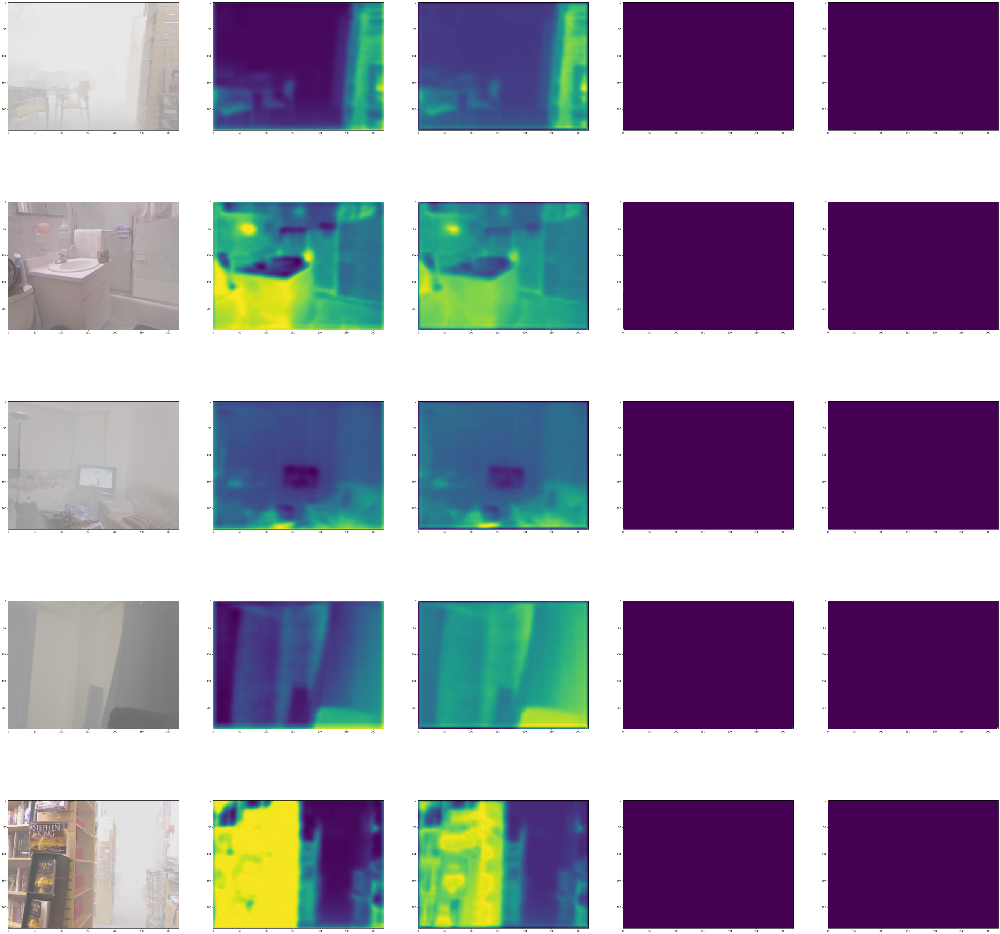

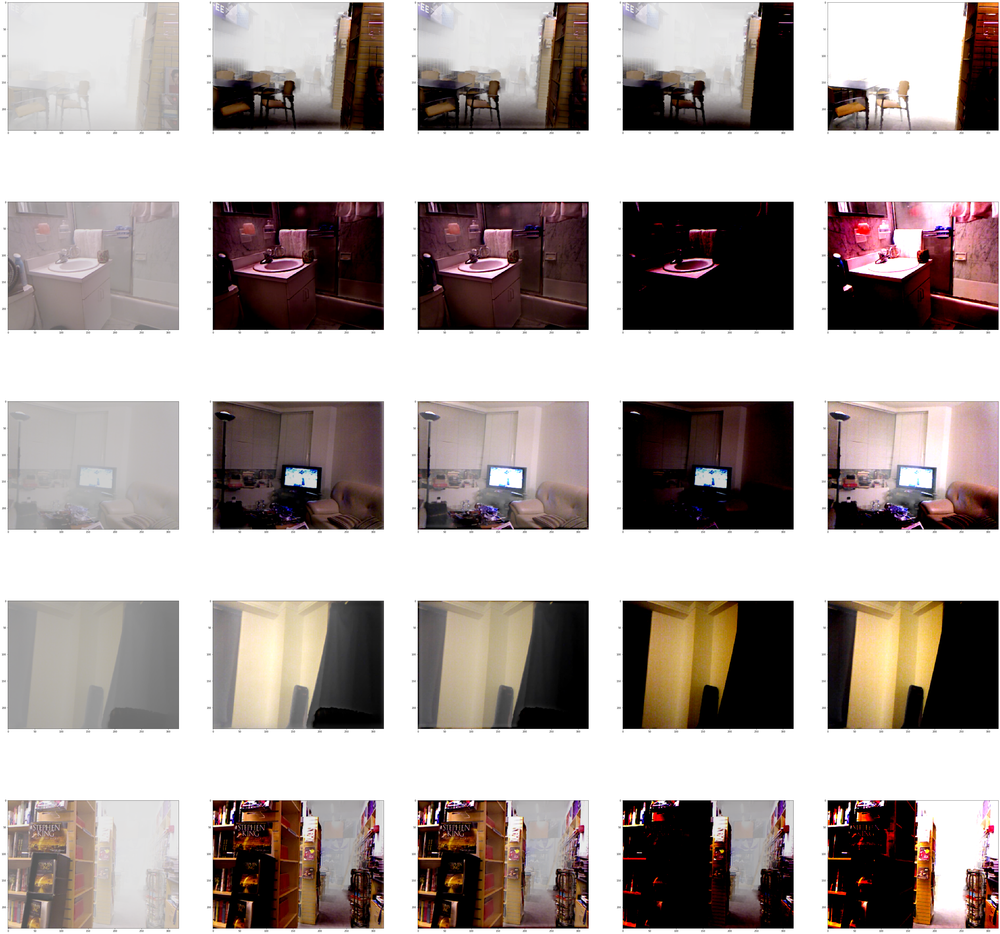

In [6]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [7]:
met=compute_metrics(models,tst_file)
display(met)

,psnr_orig,psnr_best,psnr_tmap,ssim_orig,ssim_best,ssim_tmap,model_name
0,8.734673,14.100104,20.901150,0.526044,0.656557,0.724311,base
1,9.925823,16.418651,20.539201,0.604556,0.746404,0.710340,patch_1
2,5.585092,9.846294,13.845181,0.317889,0.410807,0.183240,patch_3
3,8.112637,13.580756,13.845181,0.495393,0.630477,0.183240,patch_5


#### Gradient Similarity Update

In [8]:
model_paths={"base":"../saved_models/base/model_50",
             "patch_1":"../saved_models/p1_g1/model_50",
              "patch_3":"../saved_models/p3_g1/model_50",
                "patch_5":"../saved_models/p5_g1/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
# models["ground_truth"]=""

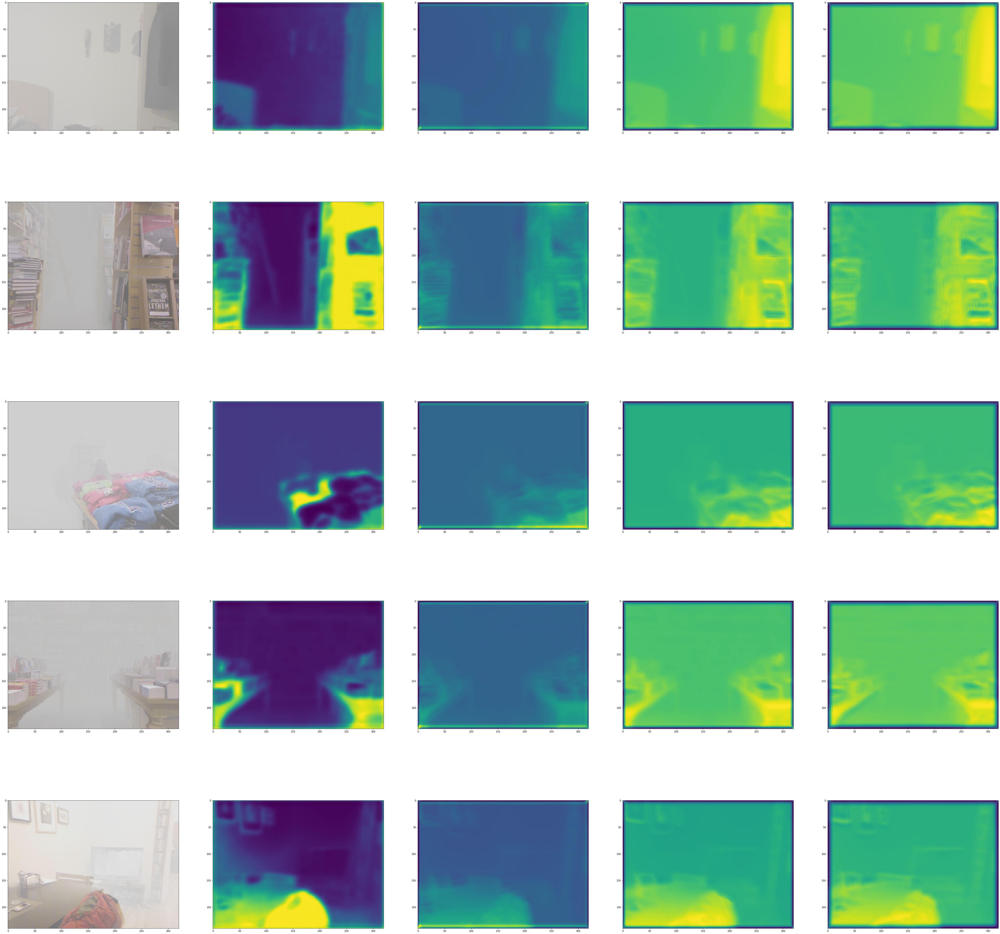

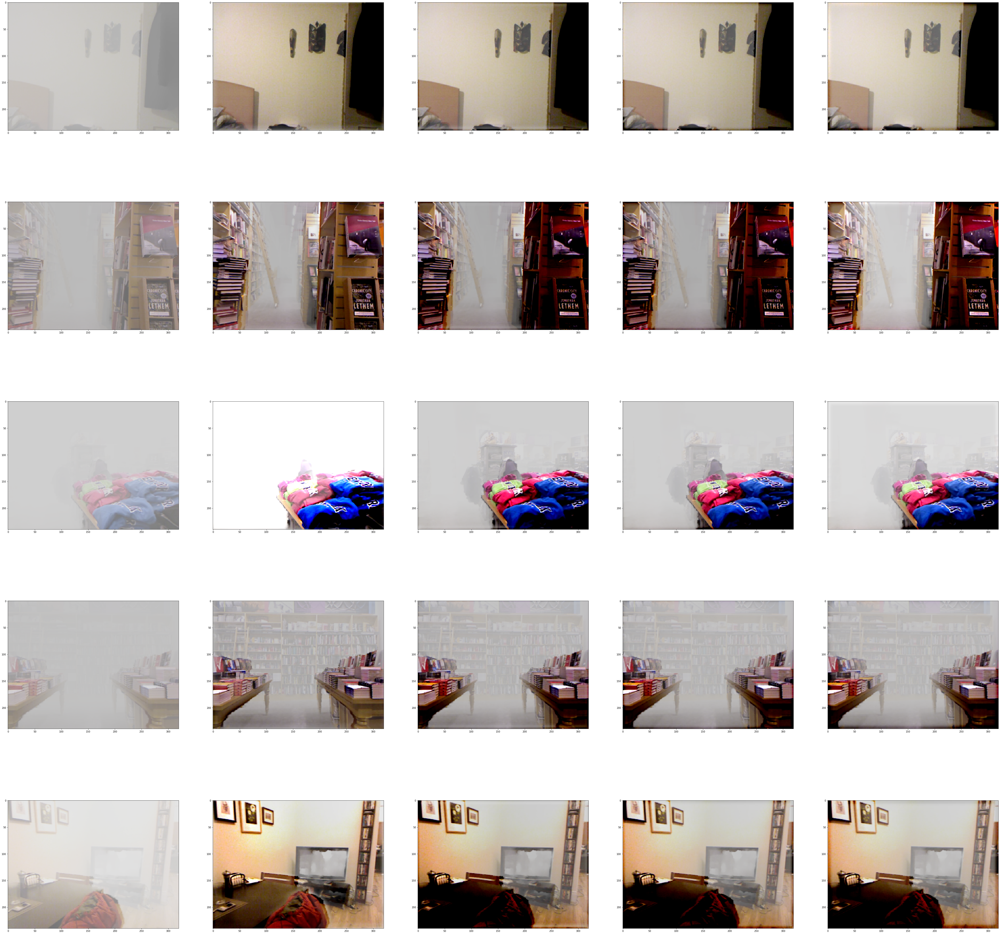

In [9]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [10]:
met=compute_metrics(models,tst_file)
display(met)

,psnr_orig,psnr_best,psnr_tmap,ssim_orig,ssim_best,ssim_tmap,model_name
0,8.734673,14.100104,20.901150,0.526044,0.656557,0.724311,base
1,9.057753,15.216916,18.326258,0.550585,0.671298,0.673456,patch_1
2,9.442831,15.223877,17.708591,0.583998,0.693528,0.664750,patch_3
3,9.647122,14.875046,17.307720,0.595597,0.699366,0.655023,patch_5


### Scaling Coefficient

#### Normal Update

In [11]:
model_paths={"base":"../saved_models/base/model_50",
             "patch_1":"../saved_models/s10_g0/model_50",
              "patch_3":"../saved_models/s100_g0/model_50",
                "patch_5":"../saved_models/s1000_g0/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
# models["ground_truth"]=""

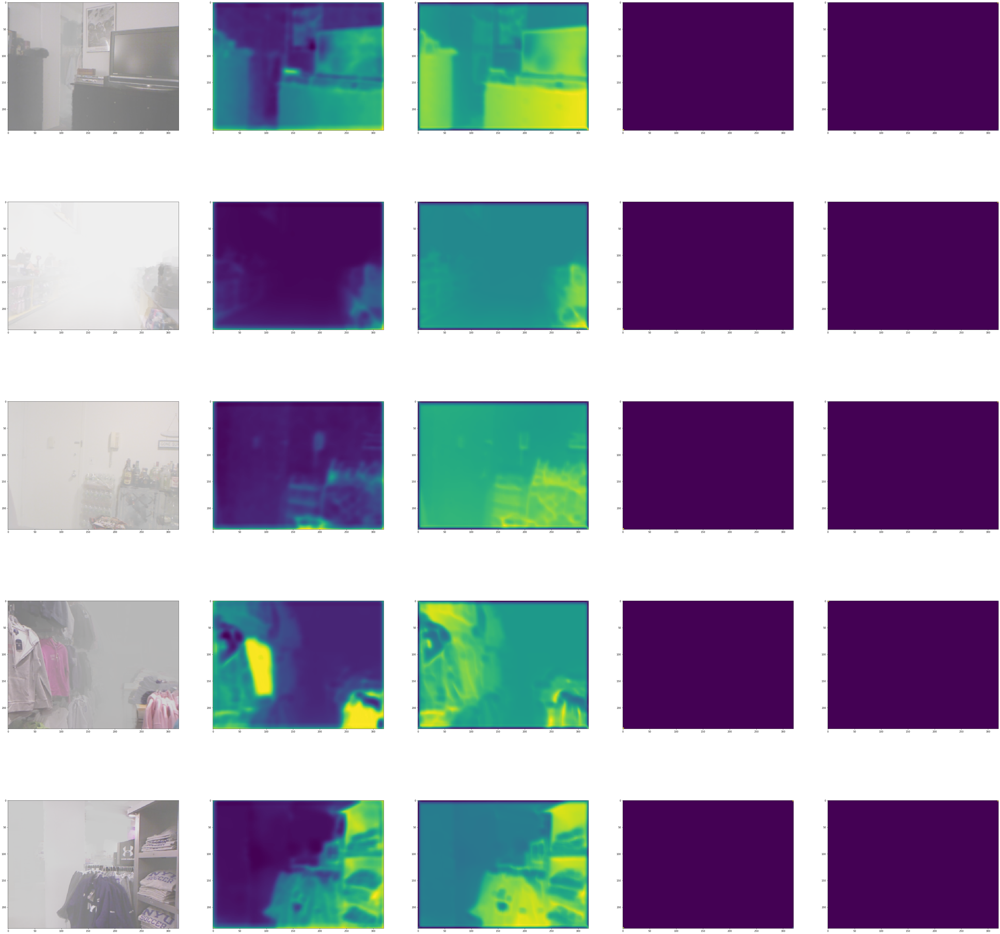

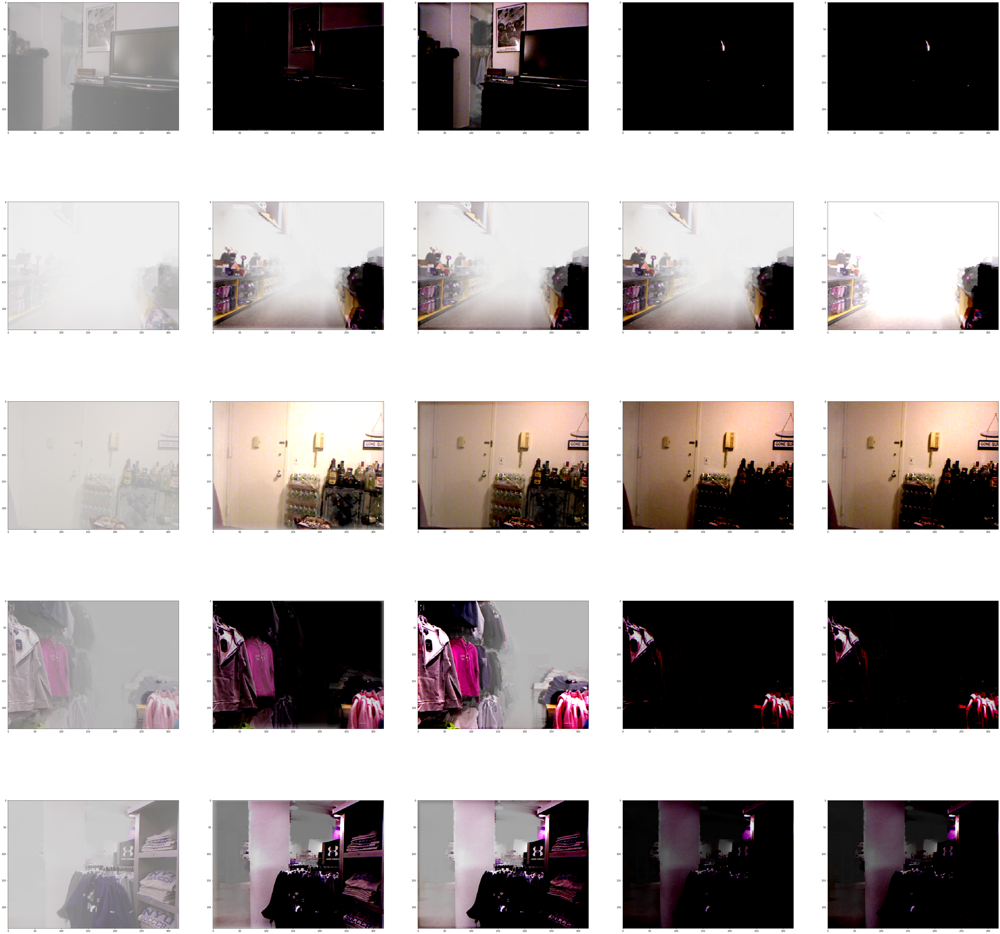

In [12]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [13]:
met=compute_metrics(models,tst_file)
display(met)

,psnr_orig,psnr_best,psnr_tmap,ssim_orig,ssim_best,ssim_tmap,model_name
0,8.734673,14.100104,20.901150,0.526044,0.656557,0.724311,base
1,8.631072,15.077537,18.570605,0.528289,0.658703,0.680066,patch_1
2,6.018097,10.852132,13.845181,0.341020,0.444228,0.183240,patch_3
3,6.712798,10.926209,13.845181,0.364493,0.466360,0.183240,patch_5


#### Gradient Similarity Update

In [14]:
model_paths={"base":"../saved_models/base/model_50",
             "patch_1":"../saved_models/s10_g1/model_50",
              "patch_3":"../saved_models/s100_g1/model_50",
                "patch_5":"../saved_models/s1000_g1/model_50"
            }
models={}
for key in model_paths:
    mpath=model_paths[key]
    model = torch.load(mpath)
    models[key]=(model)
# models["ground_truth"]=""

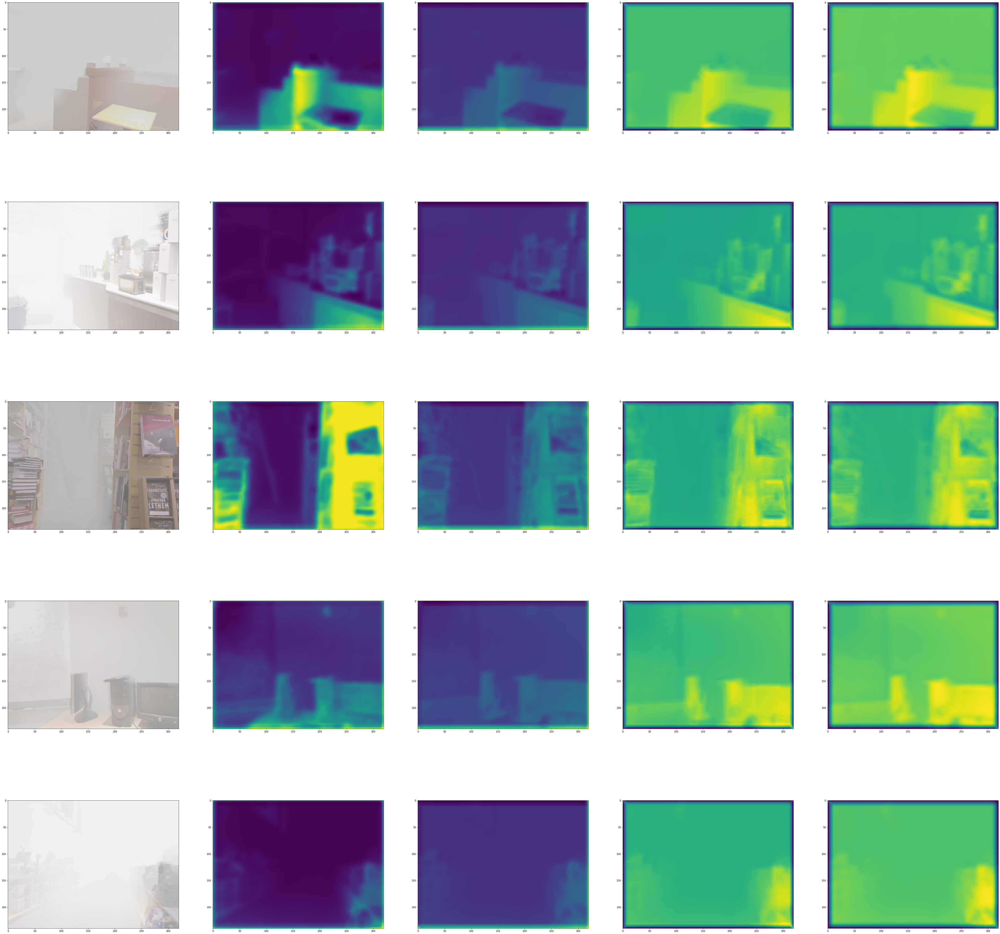

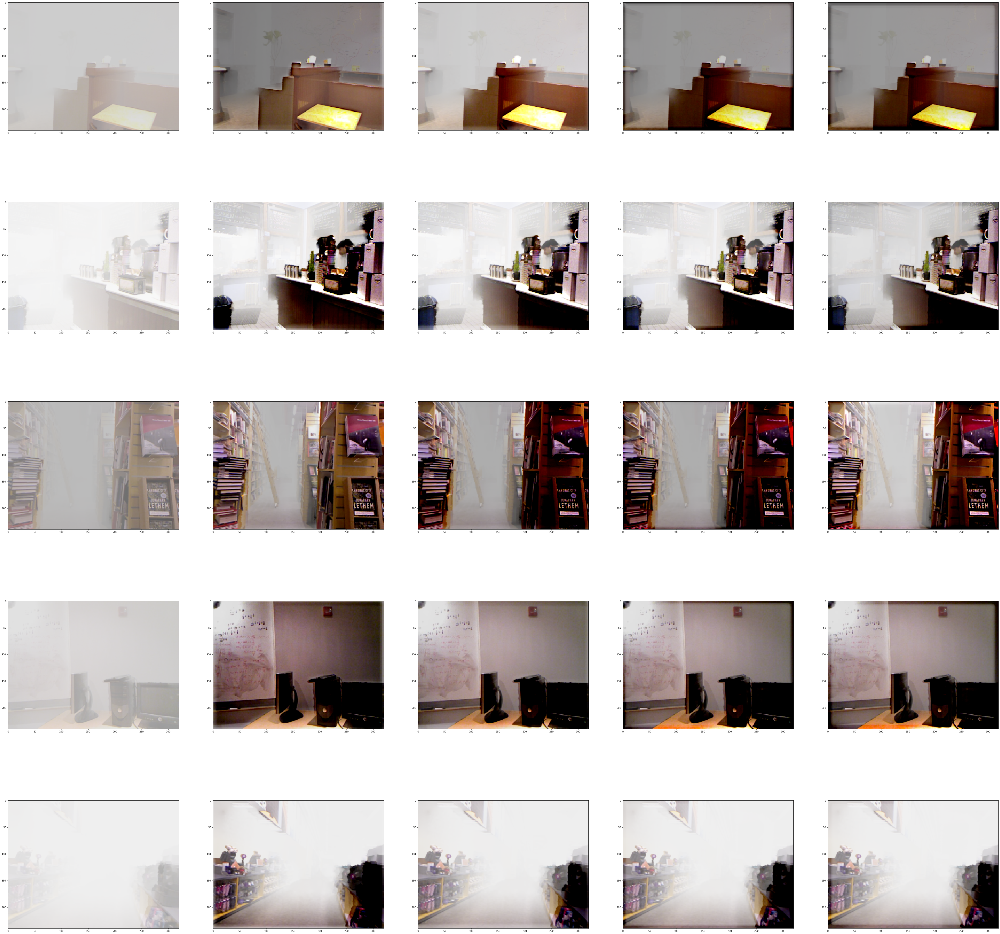

In [15]:
random_idcs=np.random.permutation(tst_file["hazy_image"].shape[0])[:5]
compare_models_on_images(models,tst_file,random_idcs,transmaps=True)
compare_models_on_images(models,tst_file,random_idcs,transmaps=False)

In [16]:
met=compute_metrics(models,tst_file)
display(met)

,psnr_orig,psnr_best,psnr_tmap,ssim_orig,ssim_best,ssim_tmap,model_name
0,8.734673,14.100104,20.901150,0.526044,0.656557,0.724311,base
1,9.704428,15.664434,18.056884,0.583711,0.697914,0.673297,patch_1
2,9.148298,14.862136,17.848752,0.567842,0.683551,0.665046,patch_3
3,9.266314,14.807105,17.561510,0.577071,0.690229,0.658690,patch_5
